# City of Toronto Zoning By-Law Data

The City of Toronto's Zoning By-law dataset, available on the Open Data Portal, provides information on zoning regulations within the city. The By-Laws 569-2013 was adopted by the City in 2013. This dataset is essential for understanding land use designations, building requirements, and permissible activities across different zones in Toronto. It serves as a valuable resource for urban planners, developers, and residents interested in the city's zoning framework.


## Setup Notebook

In [219]:
# Import 3rd party libraries
import numpy as np
import pandas as pd
import seaborn as sns
import geopandas as gpd
import folium
import matplotlib.pylab as plt

# Configure Notebook
%matplotlib inline
plt.style.use('fivethirtyeight')
sns.set_context("notebook")
import warnings
warnings.filterwarnings('ignore')

## Import City of Toronto Zoning By-Law Geojson File

This GeoJSON file contains 11,719 rows, each representing a zoning area in the City of Toronto. Each feature includes properties like zoning classifications, frontage, density, and coverage, alongside geometries like MultiPolygon for spatial representation.

In [222]:
# Import dataset as a GeoDataFrame
zoning_data = gpd.read_file('Zoning Area - 4326.geojson')

# View GeoDataFrame
zoning_data.head()

,_id,GEN_ZONE,ZN_ZONE,ZN_HOLDING,HOLDING_ID,FRONTAGE,ZN_AREA,UNITS,DENSITY,COVERAGE,...,ZN_EXCPTN,EXCPTN_NO,STAND_SET,ZN_STATUS,ZN_STRING,AREA_UNITS,ZBL_CHAPT,ZBL_SECTN,ZBL_EXCPTN,geometry
0,1,2,UT,N,0,-1.0,-1,-1,-1.0,0.0,...,N,0,-1,2,UT,-1.0,100,100.10,,"MULTIPOLYGON (((-79.2097 43.81729, -79.20961 4..."
1,2,1,ON,N,0,-1.0,-1,-1,-1.0,0.0,...,N,0,-1,0,ON,-1.0,90,90.20,,"MULTIPOLYGON (((-79.50273 43.70976, -79.50195 ..."
2,3,0,RD,N,0,14.0,510,0,0.0,0.0,...,Y,1058,-1,2,RD (f14.0; a510) (x1058),0.0,10,10.20,900.3.10(1058),"MULTIPOLYGON (((-79.27433 43.80068, -79.27425 ..."
3,4,1,O,N,0,-1.0,-1,-1,-1.0,0.0,...,N,0,-1,3,O,-1.0,90,90.10,,"MULTIPOLYGON (((-79.5704 43.72175, -79.57042 4..."
4,5,0,RD,N,0,0.0,0,0,0.0,0.0,...,Y,1040,-1,2,RD (x1040),0.0,10,10.20,900.3.10(1040),"MULTIPOLYGON (((-79.26202 43.81195, -79.26214 ..."


## Data Analysis

Let's explore the features within the zoning dataset.

In [225]:
# Check the number of columns and rows
zoning_data.shape

(11719, 25)

In [226]:
# Check the columns in GeoDataFrame
zoning_data.columns

Index(['_id', 'GEN_ZONE', 'ZN_ZONE', 'ZN_HOLDING', 'HOLDING_ID', 'FRONTAGE',
       'ZN_AREA', 'UNITS', 'DENSITY', 'COVERAGE', 'FSI_TOTAL', 'PRCNT_COMM',
       'PRCNT_RES', 'PRCNT_EMMP', 'PRCNT_OFFC', 'ZN_EXCPTN', 'EXCPTN_NO',
       'STAND_SET', 'ZN_STATUS', 'ZN_STRING', 'AREA_UNITS', 'ZBL_CHAPT',
       'ZBL_SECTN', 'ZBL_EXCPTN', 'geometry'],
      dtype='object')

From the website that this data was obtained from (https://open.toronto.ca/dataset/zoning-by-law/), the columns describe the following:

- '_id': Unique row identifier for Open Data database.
- 'GEN_ZONE': The land use category of the lands within the zone boundary. Each 'zone category' has its own Chapter in the text of By-law 569-2013. 0 = Residential 1 = Open Space 2 = Utility and Transportation 4 = Employment Industrial 5 = Institutional 6 = Commercial Residential Employment 101 = Residential Apartment 201 = Commercial 202 = Commercial Residential.
- 'ZN_ZONE': The land use category of the lands within the zone boundary. Each 'zone category' has its own Chapter in the text of By-law 569-2013. 
- 'ZN_HOLDING':To indicate whether there is a HOLDING status for the zone. The zone label will be prefaced by the letter (H). These are not common, and when used, a Holding Zone is most often applied to specific sites. Yes (Y) or No (N).
- 'HOLDING_ID': Holding number if it exists.
- 'FRONTAGE': The required minimum Lot Frontage in the zone, and is a numeric value prefaced by the letter 'f' within a residential zone label. Unit = metres.
- 'ZN_AREA':The required minimum Lot Area in the zone, and is a numeric value prefaced by the letter 'a' within a residential zone. Unit = square metres.
- 'UNITS': The permitted maximum number of Dwelling Units allowed on a lot in the zone, and is a numeric value prefaced by the letter 'u' in a residential zone.
- 'DENSITY': The permitted maximum Density in the zone by FSI (floor space index), and is a numeric value prefaced by the letter 'd' in residential zones.
- 'COVERAGE': The permitted maximum percentage of a lot that can be covered by any part of any building or structure on or above the surface of the lot. Unit = % (percent).
- 'FSI_TOTAL': The permitted maximum FSI (floor space index) Total in the zone. It is a numeric value following the zone symbol.
- 'PRCNT_COMM': The permitted maximum FSI (floor space index) for Commercial Use in most mixed-use zones, and is a numeric value prefaced by letter 'c' in the zone label.
- 'PRCNT_RES': The permitted maximum FSI (floor space index) for Residential Use in most mixed-use zones, and is a numeric value prefaced by the letter 'r' in the zone label.
- 'PRCNT_EMMP': The permitted maximum FSI (floor space index) for Employment Uses in the zone, and is a numeric value prefaced by the letter 'e' in the zone label.
- 'PRCNT_OFFC': The permitted maximum FSI (floor space index) for Office Uses in an Employment-Office zone, and is a numeric value prefaced by the letter 'o' in the zone label.
- 'ZN_EXCPTN': This indicates whether a zone has an Exception. Yes (Y) or No (N).
- 'EXCPTN_NO': This is the Exception Number for the zone if one exists. The exception number is prefaced by the letter 'x' in the zone label. Each zone has its own series of exception numbers, starting at 1, so the exception number must be read in conjunction with the respective zone symbol.
- 'STAND_SET': Set of standards referred to in the Commercial-Residential mixed use zone, based on three different design typologies. The 'standard set' number is prefaced by the letters 'SS' in the zone label.
- 'ZN_STATUS': Status of the Zone, primarily indicating whether the lands have been incorporated into By-law 569-2013 or not. 0-4 and 6 = In the By-law. 5 = Not Part of Zoning By-law 569-2013.
- 'ZN_STRING': Complete label of the zone.
- 'AREA_UNITS': This is also a type of density limit, indicating the required minimum lot area per dwelling unit on a lot in the zone. Unit = square metres.
- 'ZBL_CHAPT': By-law text chapter number.
- 'ZBL_SECTN': By-law text section number.
- 'ZBL_EXCPTN': By-law text exception number.

Most of the features will not represent any correlation to traffic collision data, therefore, they can be dropped. The following columns are dropped:

'ZN_HOLDING' and 'HOLDING_ID': These features have nothing to do with collision data because they pertain to zoning regulations, specifically indicating if a zone has a "holding" status. 

'FRONTAGE' and 'ZN_AREA': These features have no direct relation to collision data because they describe land-use regulations, specifically the minimum dimensions for lot frontage and area within a zoning context. 

'COVERAGE': All rows in the coverage column are zero, therefore no information is being provided by this feature. 

'PRCNT_COMM', 'PRCNT_RES','PRCNT_EMMP', and 'PRCNT_OFFC': The FSI_Total will present the permitted maximum FSI (floor space index) total in the zone. Therefore, the remaining columns containing FSI values are redundant. 

'ZN_EXCPTN', 'EXCPTN_NO': These features are unrelated to collision data because they refer to specific exceptions or modifications within zoning regulations, such as unique land-use permissions or restrictions.

'STAND_SET': This feature is unrelated to collision data because it pertains to design standards for Commercial-Residential mixed-use zones.

'ZN_STATUS' and 'ZN_STRING': These features are unrelated to collision data because they provide details about zoning regulations, such as whether the zone falls under a specific by-law and the zone's complete label. 

'ZBL_CHAPT', 'ZBL_SECTN', and 'ZBL_EXCPTN': These features are unrelated to collision data because they reference specific chapters, sections, and exceptions within zoning by-law documentation. 

By removing unnecessary columns, we reduce complexity and ensure that subsequent steps in data processing and analysis are more efficient and manageable.

In [229]:
# Drop uncorrelated and unnecessary columns 
zoning_data = zoning_data.drop(columns = [
   'ZN_HOLDING', 'HOLDING_ID', 'FRONTAGE', 'ZN_AREA', 'COVERAGE',
    'PRCNT_COMM', 'PRCNT_RES', 'PRCNT_EMMP', 'PRCNT_OFFC',
    'ZN_EXCPTN', 'EXCPTN_NO', 'STAND_SET', 'ZN_STATUS', 'ZN_STRING',
    'ZBL_CHAPT', 'ZBL_SECTN', 'ZBL_EXCPTN'
    ], errors='ignore')

# Check if columns are removed
zoning_data.columns

Index(['_id', 'GEN_ZONE', 'ZN_ZONE', 'UNITS', 'DENSITY', 'FSI_TOTAL',
       'AREA_UNITS', 'geometry'],
      dtype='object')

In [230]:
# Check data types per column
print(zoning_data.dtypes)

_id              int32
GEN_ZONE         int32
ZN_ZONE         object
UNITS            int32
DENSITY        float64
FSI_TOTAL      float64
AREA_UNITS     float64
geometry      geometry
dtype: object


From the description of each feature, it is clear 'GEN_ZONE' uses numbers to classify the land type. These numbers serve as categorical labels rather than quantitative values. To ensure they are not mistakenly treated as numeric data during analysis, object descriptions will be added to make it more clear and in a proper format. The descriptions are as follows: 0 = Residential, 1 = Open Space, 2 = Utility and Transportation, 4 = Employment Industrial, 5 = Institutional, 6 = Commercial Residential Employment, 101 = Residential Apartment, 201 = Commercial, 202 = Commercial Residential.

In [232]:
# Descriptions of GEN_ZONE labels
zone_labels = {
    0: "Residential",
    1: "Open Space",
    2: "Utility and Transportation",
    4: "Employment Industrial",
    5: "Institutional",
    6: "Commercial Residential Employment",
    101: "Residential Apartment",
    201: "Commercial",
    202: "Commercial Residential"
}

# Replace numerical values in GEN_ZONE with zone labels
zoning_data['GEN_ZONE'] = zoning_data['GEN_ZONE'].replace(zone_labels)

# View GeoDataFrame
zoning_data.head()

,_id,GEN_ZONE,ZN_ZONE,UNITS,DENSITY,FSI_TOTAL,AREA_UNITS,geometry
0,1,Utility and Transportation,UT,-1,-1.0,-1.0,-1.0,"MULTIPOLYGON (((-79.2097 43.81729, -79.20961 4..."
1,2,Open Space,ON,-1,-1.0,-1.0,-1.0,"MULTIPOLYGON (((-79.50273 43.70976, -79.50195 ..."
2,3,Residential,RD,0,0.0,-1.0,0.0,"MULTIPOLYGON (((-79.27433 43.80068, -79.27425 ..."
3,4,Open Space,O,-1,-1.0,-1.0,-1.0,"MULTIPOLYGON (((-79.5704 43.72175, -79.57042 4..."
4,5,Residential,RD,0,0.0,-1.0,0.0,"MULTIPOLYGON (((-79.26202 43.81195, -79.26214 ..."


In [233]:
# Define colors for each GEN_ZONE
zone_colors = {
    "Residential": "red",
    "Open Space": "green",
    "Utility and Transportation": "dodgerblue",
    "Employment Industrial": "orange",
    "Institutional": "brown",
    "Commercial Residential Employment": "yellow",
    "Residential Apartment": "cyan",
    "Commercial": "magenta",
    "Commercial Residential": "purple"
}

# Create a Folium map 
toronto_coords = [43.65107, -79.347015]
map_zones = folium.Map(location=toronto_coords, zoom_start=10)

# Add the zoning data
folium.GeoJson(
    zoning_data,
    style_function=lambda feature: {
        "fillColor": zone_colors.get(feature["properties"]["GEN_ZONE"], "white"),  # Default to white if not found
        "color": "black", 
        "weight": 0.5,
        "fillOpacity": 0.5,
    }
).add_to(map_zones)

# Display the map
map_zones

### Zoning Legend

- **Residential**: Red
- **Open Space**: Green
- **Utility and Transportation**: Blue
- **Employment Industrial**: Orange
- **Institutional**: Brown
- **Commercial Residential Employment**: Yellow
- **Residential Apartment**: Cyan
- **Commercial**: Magenta
- **Commercial Residential**: Purple

Now let's look at the information from the 'ZN_ZONE' feature.

In [236]:
# Let's look at ZN_Zone data values
zoning_data['ZN_ZONE'].unique()

array(['UT', 'ON', 'RD', 'O', 'RM', 'RT', 'RS', 'OR', 'E', 'EL', 'CL',
       'CR', 'EH', 'RA', 'CRE', 'OC', 'I', 'R', 'RAC', 'IPW', 'EO', 'OG',
       'IE', 'IH', 'OM', 'IS'], dtype=object)

In the City of Toronto's Zoning By-law 569-2013, zoning codes are used to designate specific land uses and development standards. Understanding these abbreviations is crucial for interpreting zoning regulations. Below is a list of the zoning abbreviations and their meanings:

- R: Residential Zone
- RD: Residential Detached Zone
- RS: Residential Semi-Detached Zone
- RT: Residential Townhouse Zone
- RM: Residential Multiple-Dwelling Zone
- RA: Residential Apartment Zone
- RAC: Residential Apartment Commercial Zone
- CR: Commercial Residential Zone
- CRE: Commercial Residential Employment Zone
- E: Employment Industrial Zone
- EL: Employment Light Industrial Zone
- EH: Employment Heavy Industrial Zone
- EO: Employment Office Zone
- I: Institutional Zone
- IE: Industrial Employment
- IH: Industrial Heavy
- IPW:Industrial Park Warehousing
- IS:  Institutional Services
- O: Open Space Zone
- OC: Open Space - Conservation Zone
- OG: Open Space - Greenbelt
- OM: Open Space - Managed
- ON: Open Space Natural Zone
- OR: Open Space Recreation Zone
- UT: Utility and Transportation Zone
- CL: Commercial Local Zone

Each zoning code specifies the permitted uses, building types, densities, and other development standards applicable to properties within that zone. 

## Data Cleaning


Let's now take a look at the remaining numerical columns. 

In [240]:
# Check numerical statistics for each column
zoning_data.describe()

,_id,UNITS,DENSITY,FSI_TOTAL,AREA_UNITS
count,11719.000000,11719.000000,11719.000000,11719.000000,11719.000000
mean,5860.000000,1.867565,-0.246600,-0.223988,7.508909
std,3383.128237,25.405069,0.808751,1.688457,38.472827
min,1.000000,-1.000000,-2.000000,-3.000000,-1.000000
25%,2930.500000,-1.000000,-1.000000,-1.000000,-1.000000
50%,5860.000000,0.000000,0.000000,-1.000000,0.000000
75%,8789.500000,0.000000,0.000000,-1.000000,0.000000
max,11719.000000,988.000000,11.000000,30.000000,457.000000


We see some negative minimum values for some columns, let's determine the number of negative values.

In [242]:
# Count the number of negative values in each column
negative_counts = (zoning_data.select_dtypes(include=['number']) < 0).sum()
negative_counts

_id              0
UNITS         5332
DENSITY       5070
FSI_TOTAL     8841
AREA_UNITS    5373
dtype: int64

Almost half of the rows of UNITS, DENSITY and AREA_UNITS is negative and over half of FSI_TOTAL values are negative. Huh, this is weird. A search online brought up no information about how this is possible or why this is happening. At first, it was assumed that -1 represents 0 units, density, floor size index (FSI) and area units, but a quick code below shows that there are 0 values as well. 

In [244]:
# Count the number of zero values in each column
zero_counts = (zoning_data.select_dtypes(include=['number']) == 0).sum()
zero_counts

_id              0
UNITS         5734
DENSITY       4460
FSI_TOTAL       48
AREA_UNITS    5717
dtype: int64

The next idea could be that negative values represent a certain zone type, for example there is no density or units for an open space. Therefore let's examine the amount of negative values per zone (GEN_ZONE). 

In [246]:
# Check for negative values in the columns and return GEN_ZONE
for column in ['UNITS', 'DENSITY', 'FSI_TOTAL', 'AREA_UNITS']:
    
    # Get rows where the column has negative values
    negative_values = zoning_data[zoning_data[column] < 0]
    
    # Return the GEN_ZONE for negative values
    print(column)
    print(f"\n{negative_values[['GEN_ZONE', column]].value_counts()}\n")

UNITS

GEN_ZONE                           UNITS
Commercial Residential             -1       2162
Open Space                         -1       1576
Employment Industrial              -1        606
Residential                        -1        328
Institutional                      -1        222
Commercial                         -1        133
Utility and Transportation         -1        120
Residential Apartment              -1         95
Commercial Residential Employment  -1         90
Name: count, dtype: int64

DENSITY

GEN_ZONE                           DENSITY
Commercial Residential             -1.0       2157
Open Space                         -1.0       1576
Employment Industrial              -1.0        592
Residential                        -1.0        270
Commercial                         -1.0        133
Utility and Transportation         -1.0        120
Commercial Residential Employment  -1.0         90
Residential Apartment              -1.0         88
Institutional           

There are negative values across all area types. Therefore, the negative values cannot be impeded or replaced in any way or has any logical reason behind the values. Therefore, the features will have to be dropped. 

In [248]:
# Drop uncorrelated and unnecessary columns 
zoning_data = zoning_data.drop(columns = [
   'UNITS', 'DENSITY', 'FSI_TOTAL', 'AREA_UNITS'
    ], errors='ignore')

# View GeoDataFrame
zoning_data.head()

,_id,GEN_ZONE,ZN_ZONE,geometry
0,1,Utility and Transportation,UT,"MULTIPOLYGON (((-79.2097 43.81729, -79.20961 4..."
1,2,Open Space,ON,"MULTIPOLYGON (((-79.50273 43.70976, -79.50195 ..."
2,3,Residential,RD,"MULTIPOLYGON (((-79.27433 43.80068, -79.27425 ..."
3,4,Open Space,O,"MULTIPOLYGON (((-79.5704 43.72175, -79.57042 4..."
4,5,Residential,RD,"MULTIPOLYGON (((-79.26202 43.81195, -79.26214 ..."


Let's check if there is missing (null) or duplicated values in the dataset. 

In [250]:
# Check for missing values
zoning_data.isnull().sum()

_id         0
GEN_ZONE    0
ZN_ZONE     0
geometry    0
dtype: int64

In [251]:
# Check for duplicates
zoning_data.duplicated().sum()

0

There are no null values or duplicates in this dataset. Since this is all categorical data, there are no outliers in the numeric data to be investigated. 

## EDA

Let's plot the features to see the distributions. Let's start with the distribution of GEN_ZONE.

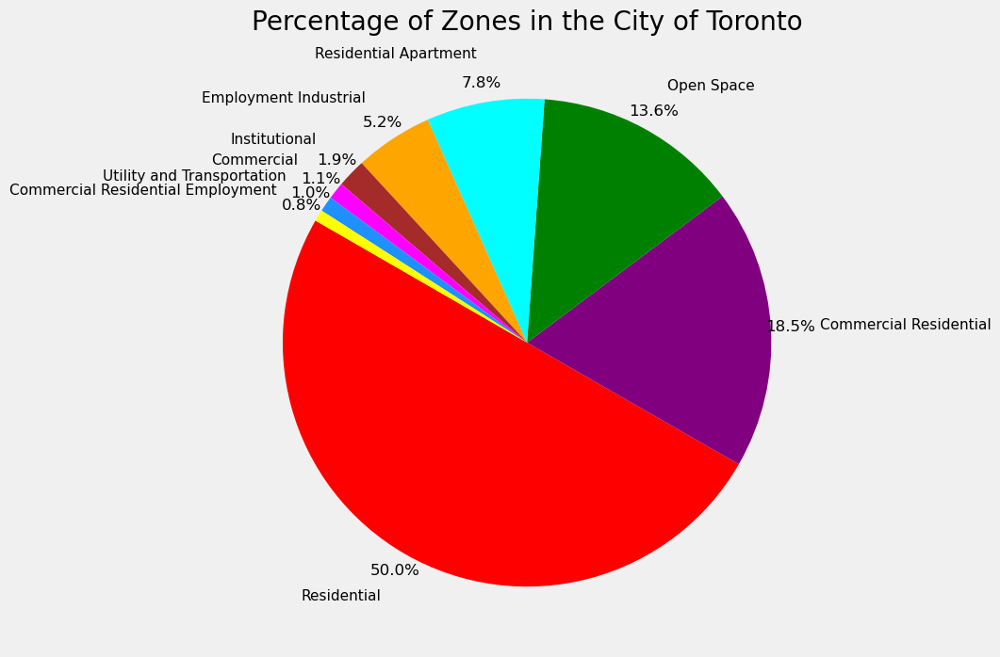

In [255]:
# Calculate the frequency of GEN_ZONE categories
gen_zone_counts = zoning_data['GEN_ZONE'].value_counts()

# Set up a color palette 
colors = [zone_colors[zone] for zone in gen_zone_counts.index]

# Plot pie chart
plt.figure(figsize=(14, 8))
gen_zone_counts.plot(
    kind='pie',
    autopct='%1.1f%%',  
    startangle=150,  
    pctdistance=1.08,  
    labeldistance=1.2,
    colors = colors
)

plt.title('Percentage of Zones in the City of Toronto', fontsize=20)
plt.ylabel(' ') # Remove the y axis

plt.show()

Now, let's look at the distribution of ZN_ZONE.

[]

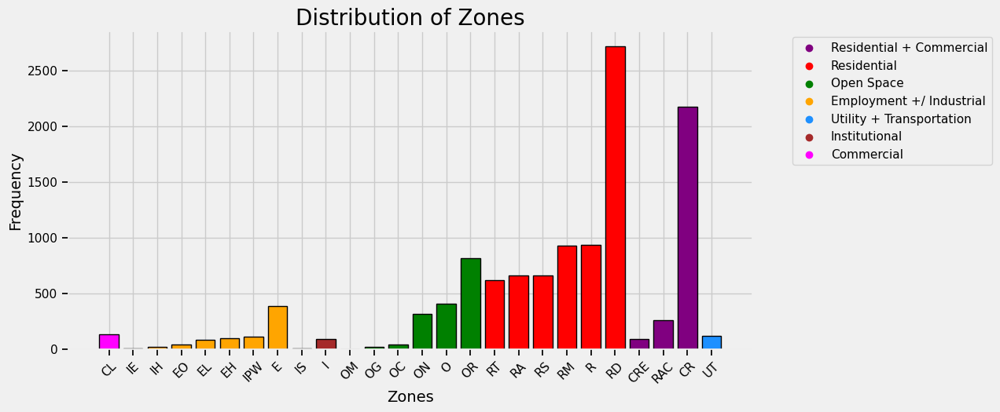

In [257]:
# Define categories and groupings
categories = {
    'Residential + Commercial': ['CRE', 'CR', 'RAC'],
    'Residential': ['R', 'RM', 'RD', 'RS', 'RA', 'RT'],
    'Open Space': ['O', 'ON', 'OG', 'OC', 'OM', 'OR'],
    'Employment +/ Industrial': ['E', 'EL', 'EH', 'EO', 'IE', 'IH', 'IP', 'IPW'],
    'Utility + Transportation': ['UT'],
    'Institutional': ['IS', 'I'],
    'Commercial': ['CL']
}

# Define color coding for the categories
category_colors = {
    'Residential + Commercial': 'purple',
    'Residential': 'red',
    'Open Space': 'green',
    'Employment +/ Industrial': 'orange',
    'Utility + Transportation': 'dodgerblue',
    'Institutional': 'brown',
    'Commercial': 'magenta'
}

# Count frequencies of ZN_ZONE
zone_counts = zoning_data['ZN_ZONE'].value_counts().reset_index()
zone_counts.columns = ['ZN_ZONE', 'Frequency']

# Map ZN_ZONE to categories
zone_to_category = {zone: category for category, zones in categories.items() for zone in zones}
zone_counts['Category'] = zone_counts['ZN_ZONE'].map(zone_to_category).fillna('Other')

# Assign the appropriate colors
zone_counts['Color'] = zone_counts['Category'].map(category_colors)

# Sort the data by category and frequency
zone_counts = zone_counts.sort_values(by=['Category', 'Frequency'])

# Plot the data
plt.figure(figsize=(10, 5))
bars = plt.bar(
    zone_counts['ZN_ZONE'], 
    zone_counts['Frequency'], 
    color=zone_counts['Color'], 
    edgecolor='black'
)

plt.title('Distribution of Zones', fontsize=20)
plt.xlabel('Zones', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.xticks(rotation=45)  

# Add legend 
for category, color in category_colors.items():
    plt.scatter([], [], color=color, label=category)
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1))
plt.plot()

## Save as a GeoJson File

ZN_ZONE was used just to represent the different types of each GEN_ZONE in EDA. It is now considered redundant and will be dropped for the remainder of the analysis. 

In [260]:
# Drop the 'ZN_ZONE' column from the GeoDataFrame
zoning_data = zoning_data.drop(columns=["ZN_ZONE"])

# Display the GeoDataFrame
zoning_data.head()

,_id,GEN_ZONE,geometry
0,1,Utility and Transportation,"MULTIPOLYGON (((-79.2097 43.81729, -79.20961 4..."
1,2,Open Space,"MULTIPOLYGON (((-79.50273 43.70976, -79.50195 ..."
2,3,Residential,"MULTIPOLYGON (((-79.27433 43.80068, -79.27425 ..."
3,4,Open Space,"MULTIPOLYGON (((-79.5704 43.72175, -79.57042 4..."
4,5,Residential,"MULTIPOLYGON (((-79.26202 43.81195, -79.26214 ..."


In [261]:
output_path = "../../Clean Data/zoning_data.geojson"
zoning_data.to_file(output_path, driver="GeoJSON")

## Import City of Toronto Ward Data

To begin analyzing the geographic distribution of bicycle collisions, we will import ward data for the City of Toronto. This dataset contains the City of Toronto ward boundaries in the WGS84 coordinate system. It has already been cleaned and analyzed in a notebook at this path: CME538_Big-Project_Hackstreet-Boys/Datasets/Ward and District Data/wards_data.ipynb. It is being imported from this path: CME538_Big-Project_Hackstreet-Boys/Clean Data/wards_data.geojson.

In [264]:
# Path to the GeoJSON file
geojson_path = "../../Clean Data/wards_data.geojson"

# Load the GeoJSON
wards_data = gpd.read_file(geojson_path)

# View GeoDataFrame
wards_data.head()

,WARD NUMBER,WARD NAME,WARD DISTRICT,geometry
0,01,Etobicoke North,Etobicoke York,"POLYGON ((614361.91 4846443.252, 614376.274 48..."
1,02,Etobicoke Centre,Etobicoke York,"POLYGON ((618769.981 4839786.381, 618770.007 4..."
2,03,Etobicoke-Lakeshore,Etobicoke York,"POLYGON ((621184.054 4834315.989, 621213.577 4..."
3,04,Parkdale-High Park,Toronto and East York,"POLYGON ((623660.782 4836061.188, 623724.263 4..."
4,05,York South-Weston,Etobicoke York,"POLYGON ((623361.036 4840391.392, 623364.743 4..."


### Combine Zoning and Ward Data Using Geospatial Relationships and Operations

Let's look at the geometry of both of the files. 

First, we must ensure they are in the same coordinate Reference Systems (CRS) in Python / GeoPandas. First, lets see the CRS information for each file. 

In [268]:
print (zoning_data.crs)
print (wards_data.crs)

EPSG:4326
EPSG:32617


We will convert from EPSG:4326 (WGS 84, geographic coordinate system) to EPSG:32617 (UTM Zone 17N, projected coordinate system) because of the following reasons:

- EPSG:4326 uses latitude and longitude in decimal degrees but EPSG:32617 uses meters as units, which will be the ideal unit when we determine the zoning areas in each ward. It can accurately measure the areas of the polygons when we require it to. 
- EPSG:32617 is tailored for regions in UTM Zone 17N, which covers the City of Toronto.

In [270]:
# Convert CRS to EPSG:32617
zoning_data = zoning_data.to_crs("EPSG:32617")  
wards_data = wards_data.to_crs("EPSG:32617")

We will now set up the goemetry features to align. First .buffer(0) will fix invalid geometries, such as self-intersections or improper polygon constructions, ensuring the data is valid for spatial operations. Then, .explode() separates multi-part geometries (multi-polygons in zoning_data) into individual components, making it easier to handle and analyze each part independently.

In [272]:
# Fix invalid geometries
zoning_data["geometry"] = zoning_data["geometry"].buffer(0)
wards_data["geometry"] = wards_data["geometry"].buffer(0)

# Explode multi-part geometries into individual parts
zoning_data = zoning_data.explode(index_parts=False)

We will use spatial relationships and operation to assign a ward number to each zoning geometry by checking which ward(s) it intersects or is contained within. If the zoning data intersects more than one ward, it will split the same zoning area to multiple rows (# rows = # wards it intersects) and returns the intersection area in that ward. 

In [274]:
def calculate_intersection_areas(zoning, wards):
    '''
    Input: GeoDataFrame
    Output: GeoDataFrame
    Description: Calculate intersection area between two datasets. 
    '''
    
    # Initialize an empty list to store new intersection areas
    rows = []

    # Iterate through each zone 
    for _, zone in zoning.iterrows():
        
        # Find all wards that intersect
        intersects = wards[wards.intersects(zone.geometry)]

        # If matches are found, calculate the intersection area for each
        for _, ward in intersects.iterrows():
            
            # Get intersection geometry
            intersection = zone.geometry.intersection(ward.geometry)

            # Calculate area
            intersection_area = intersection.area if not intersection.is_empty else 0

            # Append row
            rows.append({
                '_id': zone['_id'],  
                'GEN_ZONE': zone['GEN_ZONE'], 
                'WARD NUMBER': ward['WARD NUMBER'],  
                'WARD NAME': ward['WARD NAME'],  
                'WARD DISTRICT': ward['WARD DISTRICT'],  
                'INTERSECTION AREA': intersection_area,  
                'geometry': intersection  
            })

    # Convert the list of rows into a new GeoDataFrame
    return gpd.GeoDataFrame(rows, crs=zoning.crs, geometry='geometry')

# Apply the function
zones_in_wards = calculate_intersection_areas(zoning_data, wards_data)

# View GeoDataFrame
zones_in_wards.head()

,_id,GEN_ZONE,WARD NUMBER,WARD NAME,WARD DISTRICT,INTERSECTION AREA,geometry
0,1,Utility and Transportation,25,Scarborough-Rouge Park,Scarborough,1108.781156,"POLYGON ((643972.012 4853136.168, 643961.638 4..."
1,2,Open Space,05,York South-Weston,Etobicoke York,27616.045030,"POLYGON ((620625.736 4840692.871, 620625.673 4..."
2,3,Residential,23,Scarborough North,Scarborough,4062.776543,"POLYGON ((638815.972 4851177.422, 638785.85 48..."
3,4,Open Space,01,Etobicoke North,Etobicoke York,808.357774,"POLYGON ((615146.975 4841955.985, 615129.66 48..."
4,5,Residential,23,Scarborough North,Scarborough,3984.534186,"POLYGON ((639785.029 4852446.47, 639785.078 48..."


Let's explore a part of the data. 

In [276]:
# Review GeoDataFrame
zones_in_wards.tail(8)

,_id,GEN_ZONE,WARD NUMBER,WARD NAME,WARD DISTRICT,INTERSECTION AREA,geometry
12747,11713,Residential,11,University-Rosedale,Toronto and East York,29645.152015,"POLYGON ((630252.35 4839018.861, 630252.899 48..."
12748,11714,Residential,11,University-Rosedale,Toronto and East York,12093.037761,"POLYGON ((630040.337 4838652.802, 630038.833 4..."
12749,11715,Residential,11,University-Rosedale,Toronto and East York,7673.531120,"POLYGON ((629952.559 4838700.888, 629965.568 4..."
12750,11716,Residential,11,University-Rosedale,Toronto and East York,9172.106393,"POLYGON ((630328.572 4839174.951, 630318.048 4..."
12751,11716,Residential,15,Don Valley West,North York,17.011385,"MULTIPOLYGON (((630318.04 4839208.041, 630318...."
12752,11717,Residential,11,University-Rosedale,Toronto and East York,11241.590735,"POLYGON ((630295.307 4838532.922, 630298.386 4..."
12753,11718,Residential,11,University-Rosedale,Toronto and East York,7092.482843,"POLYGON ((630140.508 4838651.313, 630137.076 4..."
12754,11719,Residential,11,University-Rosedale,Toronto and East York,2044.035688,"POLYGON ((630211.394 4838708.402, 630211.422 4..."


In [277]:
# Check shape
zones_in_wards.shape

(12755, 7)

We can see the zoning area with the id 11716 intersects with two wards, 11 and 15, so it was split into 2 rows to show the intersection area with each of the wards. That also explains why the number of rows increased from to 12755.

It is important to note that the intersection area is in m^2, since we converted to a CRS of EPSG:32617.

In [279]:
zones_in_wards.isnull().sum()

_id                  0
GEN_ZONE             0
WARD NUMBER          0
WARD NAME            0
WARD DISTRICT        0
INTERSECTION AREA    0
geometry             0
dtype: int64

There are no null values to be investigated in the new combined dataset.

## EDA

What we are really interested in is in each ward, what percent of the area is residential, commericial, industrial etc. Now that we have combined the two datasets and the zonng_data included the columns GEN_ZONE , we can use those features to determine the percents.

In [283]:
# Function to calculate the percentage of each GEN_ZONE in each ward
def gen_zone_percent_by_ward(gdf):
    """
    Input: GeoDataFrame
    Output: GeoDataFrame
    Description: Calculate the percentage of each GEN_ZONE in each ward
    """
    
    # Group by WARD NUMBER and GEN_ZONE and sum intersection areas
    grouped = gdf.groupby(["WARD NUMBER", "GEN_ZONE"])["INTERSECTION AREA"].sum().reset_index()

    # Calculate the total area for each ward
    total_area_by_ward = grouped.groupby("WARD NUMBER")["INTERSECTION AREA"].sum().reset_index()
    total_area_by_ward.rename(columns={"INTERSECTION AREA": "TOTAL AREA"}, inplace=True)

    # Merge the total area into the grouped data
    merged = grouped.merge(total_area_by_ward, on="WARD NUMBER")

    # Calculate the percentage of each GEN_ZONE in each ward
    merged["PERCENTAGE"] = (merged["INTERSECTION AREA"] / merged["TOTAL AREA"]) * 100

    # Pivot rows and columns
    percentage_df = merged.pivot(index="WARD NUMBER", columns="GEN_ZONE", values="PERCENTAGE")

    return percentage_df

# Apply the function
gen_zone_by_ward = gen_zone_percent_by_ward(zones_in_wards)

# View GeoDataFrame
gen_zone_by_ward.head()

GEN_ZONE,Commercial,Commercial Residential,Commercial Residential Employment,Employment Industrial,Institutional,Open Space,Residential,Residential Apartment,Utility and Transportation
WARD NUMBER,,,,,,,,,
01,0.181988,0.890797,NaN,32.809600,0.973783,18.977204,31.521849,3.385092,11.259686
02,0.256798,1.727357,NaN,0.620947,0.213832,20.512481,66.968959,4.579583,5.120043
03,0.034497,3.081610,0.096093,26.866653,0.792144,11.562932,46.426684,2.640596,8.498791
04,NaN,6.443568,NaN,0.367900,0.427156,13.539027,74.533712,0.339431,4.349207
05,0.042658,3.190665,NaN,7.747211,0.009262,21.038865,56.660170,5.307575,6.003594


We see that there are null values, mostly for Commercial Residential Employment Zones. This is because these types of zones are not present in all of the wards, therefore bringing a null value. We will just replace it with a 0%. 

In [285]:
# Check null values
gen_zone_by_ward.isnull().sum()

GEN_ZONE
Commercial                            8
Commercial Residential                0
Commercial Residential Employment    22
Employment Industrial                 1
Institutional                         1
Open Space                            0
Residential                           0
Residential Apartment                 3
Utility and Transportation            0
dtype: int64

In [286]:
# Replace null values with zeroes
gen_zone_by_ward.fillna(0, inplace=True)

In [287]:
# Check null values
gen_zone_by_ward.isnull().sum()

GEN_ZONE
Commercial                           0
Commercial Residential               0
Commercial Residential Employment    0
Employment Industrial                0
Institutional                        0
Open Space                           0
Residential                          0
Residential Apartment                0
Utility and Transportation           0
dtype: int64

We can see now that each ward number is in the rows and the columns represent the percentage of each zoning area type. 

Now let's plot the distribution for all of the zoning area types in each ward. 

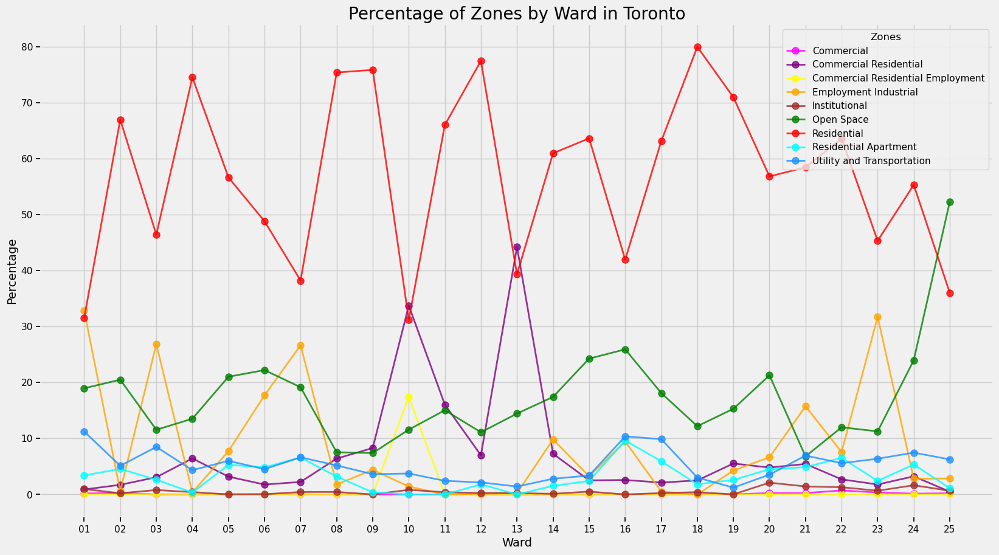

In [289]:
# Plot the scatter plot with lines for percentages
plt.figure(figsize=(18, 10))
gen_zone_colors = {gen_zone: zone_colors[gen_zone] for gen_zone in gen_zone_by_ward.columns}

for gen_zone in gen_zone_by_ward.columns:
    plt.plot(
        gen_zone_by_ward.index,
        gen_zone_by_ward[gen_zone],
        color=gen_zone_colors[gen_zone],
        marker='o', 
        markersize=8,
        linewidth=2,  
        alpha=0.8,
        label=gen_zone
    )
    

plt.legend(title="Zones")
plt.title("Percentage of Zones by Ward in Toronto", fontsize=20)
plt.xlabel("Ward", fontsize=14)
plt.ylabel("Percentage", fontsize=14)

plt.show()

We will repeat the same process for 'Ward District' now. 

In [291]:
def gen_zone_percent_by_district(gdf):
    """
    Input: GeoDataFrame
    Output: GeoDataFrame
    Description: Calculate the percentage of each GEN_ZONE in each ward district
    """
    
    # Group by WARD DISTRICT and GEN_ZONE to sum the intersection areas
    grouped = gdf.groupby(["WARD DISTRICT", "GEN_ZONE"])["INTERSECTION AREA"].sum().reset_index()

    # Calculate the total area for each ward district
    total_area_by_district = grouped.groupby("WARD DISTRICT")["INTERSECTION AREA"].sum().reset_index()
    total_area_by_district.rename(columns={"INTERSECTION AREA": "TOTAL AREA"}, inplace=True)

    # Merge the total area into the grouped data
    merged = grouped.merge(total_area_by_district, on="WARD DISTRICT")

    # Calculate the percentage of each GEN_ZONE in each ward district
    merged["PERCENTAGE"] = (merged["INTERSECTION AREA"] / merged["TOTAL AREA"]) * 100

    # Pivot rows and columns
    percentage_df = merged.pivot(index="WARD DISTRICT", columns="GEN_ZONE", values="PERCENTAGE")

    return percentage_df

# Apply the function to calculate percentages
gen_zone_by_district = gen_zone_percent_by_district(zones_in_wards)

# View GeoDataFrame
gen_zone_by_district.head()

GEN_ZONE,Commercial,Commercial Residential,Commercial Residential Employment,Employment Industrial,Institutional,Open Space,Residential,Residential Apartment,Utility and Transportation
WARD DISTRICT,,,,,,,,,
Etobicoke York,0.123457,2.077481,0.020639,19.897617,0.547372,18.039783,47.192386,4.272866,7.828398
North York,0.016882,2.904922,NaN,5.969132,0.280243,19.108929,61.243843,4.572542,5.903506
Scarborough,0.294034,2.646710,NaN,10.189376,1.195838,26.651690,49.411349,3.540032,6.070971
Toronto and East York,0.004089,11.190397,0.728647,3.169447,0.226572,13.588976,67.318968,1.102948,2.669956


We see there are null values, let's take a look.

In [293]:
gen_zone_by_district.isnull().sum()

GEN_ZONE
Commercial                           0
Commercial Residential               0
Commercial Residential Employment    2
Employment Industrial                0
Institutional                        0
Open Space                           0
Residential                          0
Residential Apartment                0
Utility and Transportation           0
dtype: int64

These null values are because not all zones are present in every district. We will fill them with zero values to represent 0%. 

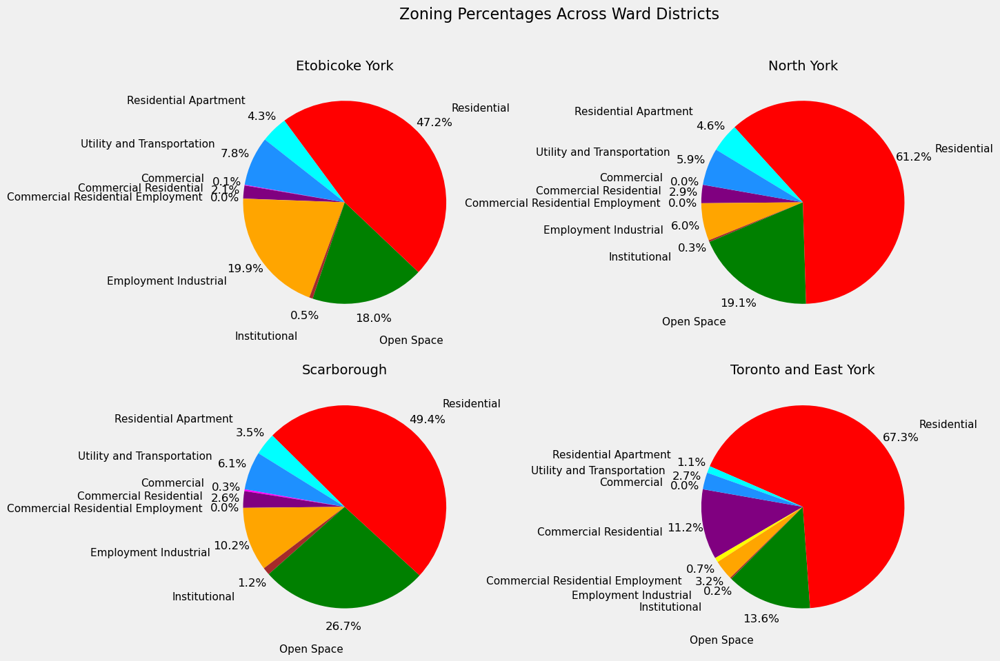

In [295]:
# Fill null values
gen_zone_by_district = gen_zone_by_district.fillna(0)

# Define the number of plots and their arrangement
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
fig.suptitle("Zoning Percentages Across Ward Districts", fontsize=16)

# Define the districts and axes
districts = gen_zone_by_district.index[:4] 
axes = axes.flatten()

# Create a pie chart for each district
for i, district in enumerate(districts):
    ax = axes[i]
    district_data = gen_zone_by_district.loc[district]
    colors = [zone_colors[zone] for zone in district_data.index]
    ax.pie(
        district_data,
        labels=district_data.index,
        startangle=170,
        autopct='%1.1f%%',
        pctdistance=1.18,  
        labeldistance=1.4,
        colors=colors
    )
    ax.set_title(district, fontsize=14)

plt.show()

## Import Bicycle Network File

This dataset contains the City of Toronto cycling network. It has already been cleaned and analyzed in a notebook at this path: CME538_Big-Project_Hackstreet-Boys/Datasets/Cycling Network Data/bicycle_data.ipynb. It is being imported from this path: CME538_Big-Project_Hackstreet-Boys/Clean Data/bicycle_data.geojson

In [298]:
# Path to the GeoJSON file
geojson_path = "../../Clean Data/bicycle_data.geojson"

# Load the shapefile
bicycle_data = gpd.read_file(geojson_path)

# View GeoDataFrame
bicycle_data.head()

,_id,INSTALLED,UPGRADED,STREET_NAME,INFRA_LOWORDER,geometry
0,1,2001,2021,Kilbarry Rd,Sharrow,"MULTILINESTRING ((-79.40351 43.69526, -79.4030..."
1,2,2001,2009,Martin Goodman / Waterfront Trl,MUP and Park,"MULTILINESTRING ((-79.40364 43.63499, -79.4035..."
2,3,2001,2011,Gatineau Hydro Corridor Trl,MUP and Park,"MULTILINESTRING ((-79.27522 43.74158, -79.2751..."
3,4,2001,2011,G Ross Lord Park Trl,MUP and Park,"MULTILINESTRING ((-79.46772 43.77208, -79.4675..."
4,5,2001,2012,Etobicoke Creek Trl,MUP and Park,"MULTILINESTRING ((-79.54812 43.59027, -79.5480..."


In [299]:
# Check the shape
bicycle_data.shape

(1464, 6)

### Combine With Bicycle Networks Using Geospatial Relationships and Operations

First, we must ensure they are in the same coordinate Reference Systems (CRS) in Python / GeoPandas. First, lets see the CRS information for each file.

In [302]:
print (zones_in_wards.crs)
print (bicycle_data.crs)

EPSG:32617
EPSG:4326


We will convert from EPSG:4326 (WGS 84, geographic coordinate system) to EPSG:32617 (UTM Zone 17N, projected coordinate system).

In [304]:
# Convert CRS to EPSG:32617
zones_in_wards = zones_in_wards.to_crs("EPSG:32617")  
bicycle_data = bicycle_data.to_crs("EPSG:32617")

In [305]:
print(zones_in_wards.crs)
print(bicycle_data.crs)

EPSG:32617
EPSG:32617


In [306]:
# Perform the spatial join
zones_wards_bicycle_data = gpd.sjoin(zones_in_wards, bicycle_data, how="inner", predicate="intersects")

# Keep correlated columns
zones_wards_bicycle_data = zones_wards_bicycle_data[[
    "WARD NUMBER", "WARD DISTRICT", "WARD NAME",
    "GEN_ZONE", "INSTALLED", "UPGRADED",
    "STREET_NAME", "INFRA_LOWORDER", "geometry"
]]

# View GeoDataFrame
zones_wards_bicycle_data.head()

,WARD NUMBER,WARD DISTRICT,WARD NAME,GEN_ZONE,INSTALLED,UPGRADED,STREET_NAME,INFRA_LOWORDER,geometry
32,14,Toronto and East York,Toronto-Danforth,Employment Industrial,2007,0,Logan Ave,Signed Route,"POLYGON ((633805.692 4835007.332, 633803.63 48..."
35,22,Scarborough,Scarborough-Agincourt,Residential,2015,0,L'Amoreaux Dr,Signed Route,"POLYGON ((636111.685 4851073.669, 636111.12 48..."
45,22,Scarborough,Scarborough-Agincourt,Residential,2020,0,Huntingwood Dr,Cycle Track,"POLYGON ((635070.994 4848957.959, 635065.45 48..."
54,07,Etobicoke York,Humber River-Black Creek,Open Space,2001,0,Humber River Recreational Trl,MUP and Park,"POLYGON ((617271.726 4843467.192, 617265.277 4..."
54,07,Etobicoke York,Humber River-Black Creek,Open Space,2001,0,Humber River Recreational Trl,MUP and Park,"POLYGON ((617271.726 4843467.192, 617265.277 4..."


Check the shape of all files

In [308]:
zones_in_wards.shape

(12755, 7)

In [309]:
bicycle_data.shape

(1464, 6)

In [310]:
zones_wards_bicycle_data.shape

(4412, 9)

It is understood that the zones_in_wards data lost data points because the bike network does not cover all of the zones and the bike data gained data points because the bike networks intersect multiple zones. 

In [312]:
zones_wards_bicycle_data.isnull().sum()

WARD NUMBER       0
WARD DISTRICT     0
WARD NAME         0
GEN_ZONE          0
INSTALLED         0
UPGRADED          0
STREET_NAME       0
INFRA_LOWORDER    0
geometry          0
dtype: int64

There are no null values or duplicates, therefore it is ready for EDA. 

## EDA

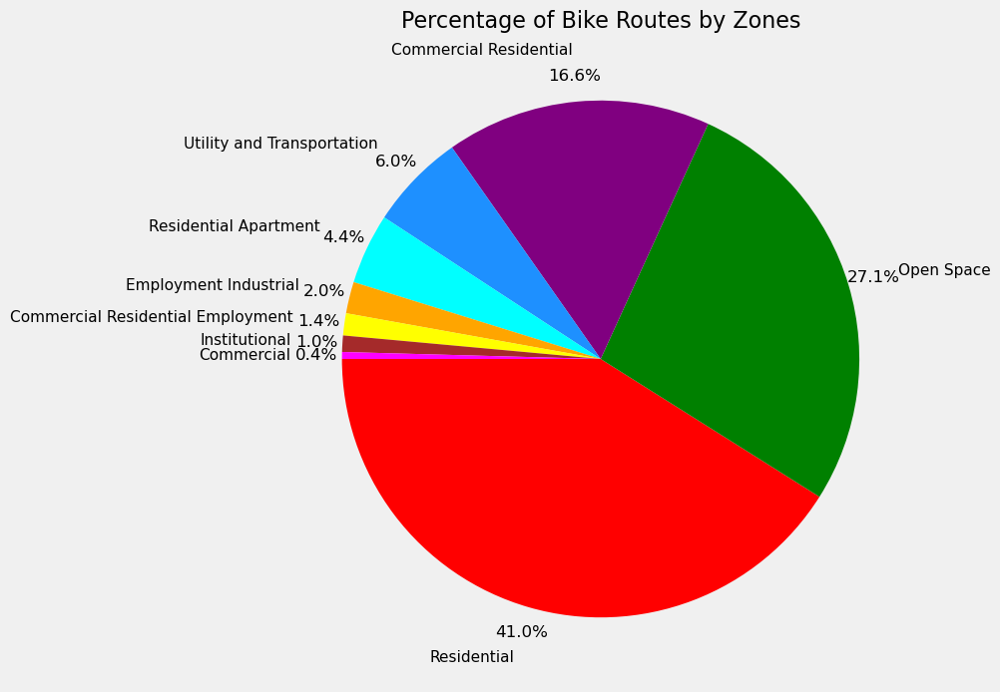

In [315]:
# Calculate bike routes per GEN_ZONE
bike_routes_per_gen_zone = zones_wards_bicycle_data['GEN_ZONE'].value_counts()

# Map colors to GEN_ZONE categories 
colors = [zone_colors[zone] for zone in bike_routes_per_gen_zone.index]

# Create the pie chart
bike_routes_per_gen_zone.plot(
    kind="pie",
    figsize=(10, 8),
    autopct="%1.1f%%",
    startangle=180,
    pctdistance=1.1,
    labeldistance=1.2,
    colors=colors
)

plt.title("Percentage of Bike Routes by Zones", fontsize=16)
plt.ylabel("")  

plt.show()

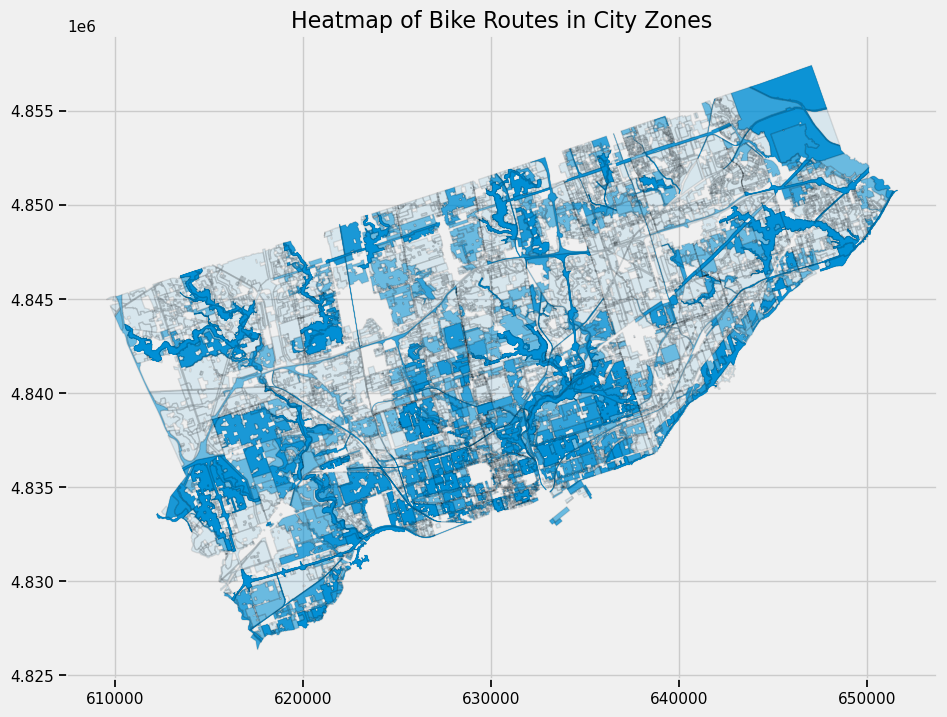

In [316]:
# Plot a heatmap of bike routes per zone
fig, ax = plt.subplots(figsize=(10, 10))
zones_wards_bicycle_data.plot(ax=ax, alpha=0.5)
zones_in_wards.plot(ax=ax, alpha=0.1, edgecolor="black")

plt.title("Heatmap of Bike Routes in City Zones", fontsize=16)
plt.show()

## Import Bicycle Collision Data

This dataset contains the City of Toronto cycling network. It has already been cleaned and analyzed in a notebook at this path: CME538_Big-Project_Hackstreet-Boys/Datasets/City of Toronto Collision Data/bicycle_collision_data.ipynb. It is being imported from this path: CME538_Big-Project_Hackstreet-Boys/Datasets/City of Toronto Collision Data/bicycle_collision_data.ipynb

In [319]:
# Path to the GeoJSON file
geojson_path = '../../Clean Data/collision_data.geojson'

# Load the shapefile
collision_data = gpd.read_file(geojson_path)

# View GeoDataFrame
collision_data.head()

,DATE,HOUR,DAY OF WEEK,MONTH,YEAR,BICYCLE,LONGITUDE,LATITUDE,geometry
0,2014-01-02,18,Thursday,1,2014,YES,-79.380272,43.648644,POINT (-79.38027 43.64864)
1,2014-01-03,11,Friday,1,2014,YES,-79.399845,43.652539,POINT (-79.39984 43.65254)
2,2014-01-09,13,Thursday,1,2014,YES,-79.405167,43.656966,POINT (-79.40517 43.65697)
3,2014-01-09,5,Thursday,1,2014,YES,-79.480613,43.665578,POINT (-79.48061 43.66558)
4,2014-01-12,22,Sunday,1,2014,YES,-79.377892,43.649143,POINT (-79.37789 43.64914)


In [320]:
# Check shape
collision_data.shape

(10402, 9)

### Combine Zoning and Bicycle Collision Data Using Geospatial Relationships and Operations

First, we must ensure they are in the same coordinate Reference Systems (CRS) in Python / GeoPandas. First, lets see the CRS information for each file.

In [323]:
print (zones_in_wards.crs)
print (collision_data.crs)

EPSG:32617
EPSG:4326


In [324]:
# Convert CRS to EPSG:32617
zones_in_wards = zones_in_wards.to_crs("EPSG:32617")  
collision_data = collision_data.to_crs("EPSG:32617")

In [325]:
print (zones_in_wards.crs)
print (collision_data.crs)

EPSG:32617
EPSG:32617


In [326]:
# Combine files
zones_wards_collision_data = gpd.sjoin(zones_in_wards, collision_data, how="inner", predicate="intersects")

# View GeoDataFrame
zones_wards_collision_data.head()

,_id,GEN_ZONE,WARD NUMBER,WARD NAME,WARD DISTRICT,INTERSECTION AREA,geometry,index_right,DATE,HOUR,DAY OF WEEK,MONTH,YEAR,BICYCLE,LONGITUDE,LATITUDE
2,3,Residential,23,Scarborough North,Scarborough,4062.776543,"POLYGON ((638815.972 4851177.422, 638785.85 48...",9866,2024-06-20,0,Thursday,6,2024,YES,-79.274685,43.801423
2,3,Residential,23,Scarborough North,Scarborough,4062.776543,"POLYGON ((638815.972 4851177.422, 638785.85 48...",5106,2019-05-25,17,Saturday,5,2019,YES,-79.274685,43.801423
19,20,Residential,01,Etobicoke North,Etobicoke York,58261.619068,"POLYGON ((613219.571 4843336.153, 613210.063 4...",2610,2016-06-25,11,Saturday,6,2016,YES,-79.598176,43.735269
35,36,Residential,22,Scarborough-Agincourt,Scarborough,1610.064153,"POLYGON ((636111.685 4851073.669, 636111.12 48...",3787,2017-07-27,15,Thursday,7,2017,YES,-79.308128,43.800145
105,106,Commercial Residential,14,Toronto-Danforth,Toronto and East York,3945.308095,"POLYGON ((632565.028 4838380.713, 632558.57 48...",7369,2022-04-18,14,Monday,4,2022,YES,-79.355838,43.687095


In [327]:
# Check shape
zones_wards_collision_data.shape

(7715, 16)

Assume the number of rows decreased because not all collisions fit into a zoning area (there are some empty areas without zones)

In [329]:
# Drop INTERSECTION AREA and index_right columns
zones_wards_collision_data = zones_wards_collision_data.drop(['_id','INTERSECTION AREA', 'index_right'], axis=1)

# Reorder columns to move geometry to the end
columns = [col for col in zones_wards_collision_data.columns if col != 'geometry'] + ['geometry']
zones_wards_collision_data = zones_wards_collision_data[columns]

# View GeoDataFrame
zones_wards_collision_data.head()

,GEN_ZONE,WARD NUMBER,WARD NAME,WARD DISTRICT,DATE,HOUR,DAY OF WEEK,MONTH,YEAR,BICYCLE,LONGITUDE,LATITUDE,geometry
2,Residential,23,Scarborough North,Scarborough,2024-06-20,0,Thursday,6,2024,YES,-79.274685,43.801423,"POLYGON ((638815.972 4851177.422, 638785.85 48..."
2,Residential,23,Scarborough North,Scarborough,2019-05-25,17,Saturday,5,2019,YES,-79.274685,43.801423,"POLYGON ((638815.972 4851177.422, 638785.85 48..."
19,Residential,01,Etobicoke North,Etobicoke York,2016-06-25,11,Saturday,6,2016,YES,-79.598176,43.735269,"POLYGON ((613219.571 4843336.153, 613210.063 4..."
35,Residential,22,Scarborough-Agincourt,Scarborough,2017-07-27,15,Thursday,7,2017,YES,-79.308128,43.800145,"POLYGON ((636111.685 4851073.669, 636111.12 48..."
105,Commercial Residential,14,Toronto-Danforth,Toronto and East York,2022-04-18,14,Monday,4,2022,YES,-79.355838,43.687095,"POLYGON ((632565.028 4838380.713, 632558.57 48..."


In [330]:
# Check null values
zones_wards_collision_data.isnull().sum()

GEN_ZONE         0
WARD NUMBER      0
WARD NAME        0
WARD DISTRICT    0
DATE             0
HOUR             0
DAY OF WEEK      0
MONTH            0
YEAR             0
BICYCLE          0
LONGITUDE        0
LATITUDE         0
geometry         0
dtype: int64

There are no null values, therefore we will move to EDA.

## Spatial EDA

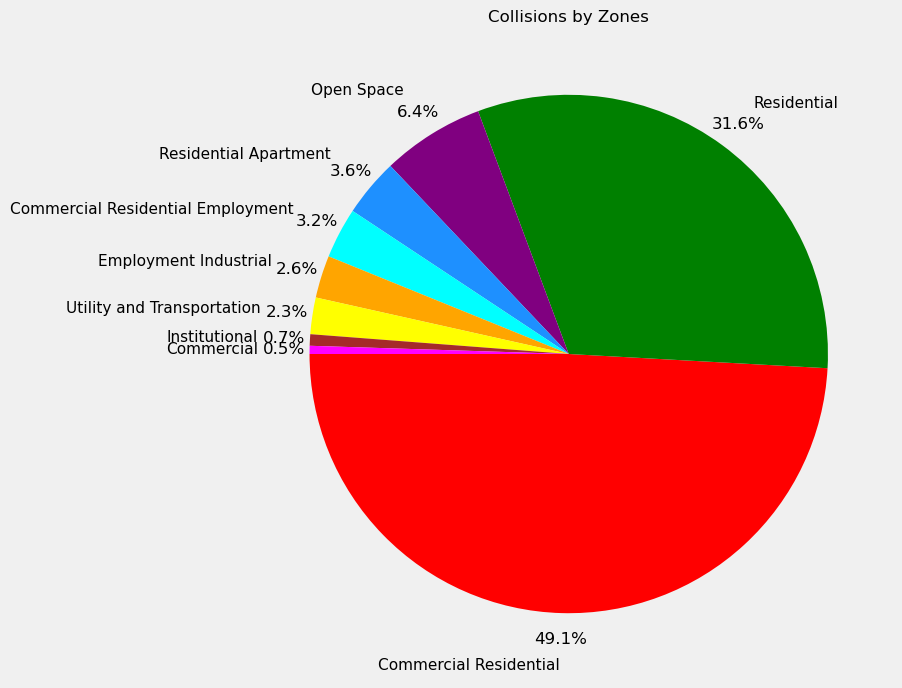

In [333]:
# Group by GEN_ZONE
collisions_by_gen_zone = zones_wards_collision_data['GEN_ZONE'].value_counts()

# Plot the pie chart
collisions_by_gen_zone.plot(
    kind="pie",
    figsize=(8, 8),
    autopct="%1.1f%%",
    startangle=180,
    pctdistance=1.1,
    colors=colors, 
    labeldistance=1.2,
    title="Collisions by Zones"
)
plt.ylabel("") 

plt.show()

[]

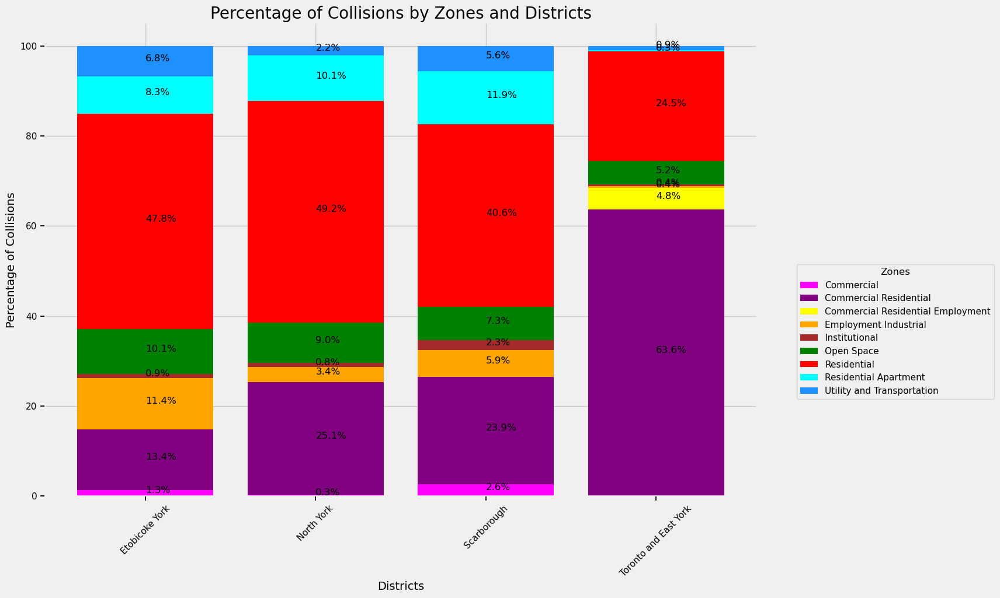

In [334]:
# Group collisions by WARD DISTRICT and GEN_ZONE and calculate percentages
collisions_by_district_zone = zones_wards_collision_data.groupby(['WARD DISTRICT', 'GEN_ZONE']).size().unstack(fill_value=0)
collisions_by_district_zone_percent = collisions_by_district_zone.div(collisions_by_district_zone.sum(axis=1), axis=0) * 100

# Plot the stacked bar chart
fig, ax = plt.subplots(figsize=(14, 10))
bottom = np.zeros(len(collisions_by_district_zone_percent))

for gen_zone in collisions_by_district_zone_percent.columns:
    ax.bar(
        collisions_by_district_zone_percent.index,
        collisions_by_district_zone_percent[gen_zone],
        bottom=bottom,
        label=gen_zone,
        color=zone_colors[gen_zone]  
    )
    bottom += collisions_by_district_zone_percent[gen_zone].values

# Annotate percentages on the bars
for i, district in enumerate(collisions_by_district_zone_percent.index):
    cumulative_height = 0
    for gen_zone in collisions_by_district_zone_percent.columns:
        height = collisions_by_district_zone_percent.loc[district, gen_zone]
        if height > 0:
            ax.text(
                i,
                cumulative_height + height / 2,
                f"{height:.1f}%"
            )
        cumulative_height += height

ax.set_title("Percentage of Collisions by Zones and Districts", fontsize=20)
ax.set_xlabel("Districts", fontsize=14)
ax.set_ylabel("Percentage of Collisions", fontsize=14)
ax.set_xticklabels(collisions_by_district_zone_percent.index, rotation=45)

ax.legend(title="Zones", bbox_to_anchor=(1.05, 0.5))
plt.plot()

## Temporal EDA

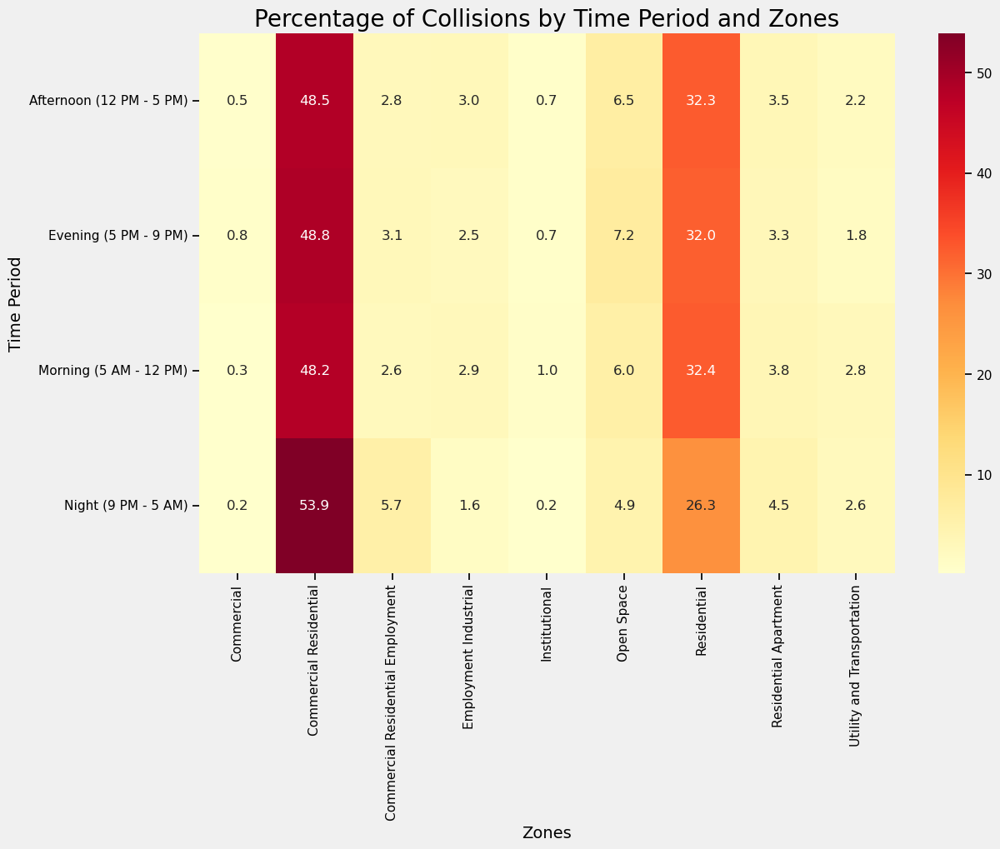

In [336]:
# Ensure HOUR column is numeric
zones_wards_collision_data['HOUR'] = pd.to_numeric(zones_wards_collision_data['HOUR'], errors='coerce')

# Define the function to categorize hours
def categorize_time(hour):
    """
    Input: row
    Output: row
    Description: Bin the hours into Morning, Afternoon, Evening, Night
    """
    if 5 <= hour < 12:
        return 'Morning (5 AM - 12 PM)'
    elif 12 <= hour < 17:
        return 'Afternoon (12 PM - 5 PM)'
    elif 17 <= hour < 21:
        return 'Evening (5 PM - 9 PM)'
    else:
        return 'Night (9 PM - 5 AM)'

# Apply the categorization 
zones_wards_collision_data['TIME OF DAY'] = zones_wards_collision_data['HOUR'].apply(categorize_time)

# Reorder categories 
time_order = ['Morning (5 AM - 12 PM)', 'Afternoon (12 PM - 5 PM)', 'Evening (5 PM - 9 PM)', 'Night (9 PM - 5 AM)']
zones_wards_collision_data['TIME OF DAY'] = pd.Categorical(
    zones_wards_collision_data['TIME OF DAY']
)

# Create a pivot table of collisions by time period and GEN_ZONE as percentages
heatmap_data_percent = zones_wards_collision_data.pivot_table(
    index='TIME OF DAY', columns='GEN_ZONE', aggfunc='size', fill_value=0
)

# Convert to percentages
heatmap_data_percent = heatmap_data_percent / heatmap_data_percent.sum(axis=1).values[:, None] * 100

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(
    heatmap_data_percent,
    cmap="YlOrRd", # Choosing colourmap in Matplotlib
    annot=True,
    fmt=".1f"
)

plt.title("Percentage of Collisions by Time Period and Zones", fontsize=20)
plt.xlabel("Zones", fontsize=14)
plt.ylabel("Time Period", fontsize=14)

plt.show()